In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
from torch.optim import Adam
from torch.optim.lr_scheduler import StepLR
import torchvision.transforms.functional as F

import numpy as np
import os
import sys
import json
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.patches as mpatches
from tqdm import tqdm


from utils.unet_model import construct_unet
from utils import img_functions

In [3]:
# root = "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/Channeled_ASU/"
# root = "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/Channeled_CWRU_Dupont/"
# root = "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/Channeled_CWRU_SunEdison/"
# root = "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/Channeled_LBNL/"
root = "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/Channeled_Combined_CWRU_LBNL_ASU/"


model_weight_paths = {
    "emma_retrained": "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/retrained_pv-vision_model.pt",
    "original": "/Users/ojas/Desktop/saj/SANDIA/pvcracks_data/pv-vision_model.pt",
}

# weight_path = model_weight_paths["emma_retrained"]
weight_path = model_weight_paths["original"]

checkpoint_name = root.split("/")[-2]

In [ ]:
def load_dataset(root):
    transformers = img_functions.Compose(
        [img_functions.ChanneledFixResize(256), img_functions.ToTensor(), img_functions.Normalize()]
    )

    train_dataset = img_functions.SolarDataset(
        root, image_folder="img/train", mask_folder="ann/train", transforms=transformers
    )

    val_dataset = img_functions.SolarDataset(
        root, image_folder="img/val", mask_folder="ann/val", transforms=transformers
    )

    return train_dataset, val_dataset

In [5]:
def load_device_and_model(weight_path):
    # device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    device = torch.device("mps")
    unet = construct_unet(5)
    unet = torch.nn.DataParallel(unet)

    model = unet.module.to(device)

    return device, model

In [6]:
def get_save_dir(base_dir, checkpoint_name):
    checkpoint_dir = base_dir + "/checkpoints/"
    folders = [folder for folder in os.listdir(checkpoint_dir)]

    max_number = 0
    for folder in folders:
        number = int(folder[-1])
        if number > max_number:
            max_number = number

    new_folder_name = f"{checkpoint_name}{max_number + 1}"
    new_folder_path = os.path.join(checkpoint_dir, new_folder_name)

    os.makedirs(new_folder_path, exist_ok=True)

    return new_folder_path

In [7]:
train_dataset, val_dataset = load_dataset(root)
device, model = load_device_and_model(weight_path)

In [8]:
category_mapping = {0: "empty", 1: "dark", 2: "busbar", 3: "crack", 4: "non-cell"}

In [9]:
import matplotlib.pyplot as plt


def new_inference_and_show(idx, threshold=0.5):
    # Get the preprocessed image and multi-hot ground truth mask
    img, mask = train_loader.dataset.__getitem__(idx)
    img = img.to(device)

    # Get the raw image for display (assuming __getraw__ returns a PIL image)
    raw_img, _ = train_loader.dataset.__getraw__(idx)

    # --- Run inference ---
    # Get raw logits from the model, then apply Sigmoid and threshold
    logits = model(img.unsqueeze(0)).detach().cpu()  # shape: [1, 5, H, W]
    probs = torch.sigmoid(logits)  # shape: [1, 5, H, W]
    pred_mask = (probs > threshold).float().squeeze(0).numpy()  # shape: [5, H, W]

    # Ground truth is assumed to be already a 5-channel multi-hot mask.
    gt_mask = mask.cpu().numpy()  # shape: [5, H, W]

    # --- Visualization ---
    # Create a grid with 3 rows and 5 columns:
    #   Row 0: Raw image (displayed only once in the first column)
    #   Row 1: Ground truth masks for each class
    #   Row 2: Predicted masks for each class
    n_classes = 5
    class_names = [f"({k}) {v}" for k, v in category_mapping.items()]

    fig, axs = plt.subplots(3, n_classes, figsize=(4 * n_classes, 12))

    # Row 0: Display raw image in first subplot; hide other subplots in this row.
    axs[0, 0].imshow(raw_img.convert("L"), cmap="viridis")
    axs[0, 0].set_title("Raw Image")
    axs[0, 0].axis("off")
    for j in range(1, n_classes):
        axs[0, j].axis("off")

    # Row 1: Ground truth for each class (each channel)
    for j in range(n_classes):
        axs[1, j].imshow(gt_mask[j], cmap="viridis")
        axs[1, j].set_title(f"GT: {class_names[j]}")
        axs[1, j].axis("off")

    # Row 2: Predictions for each class (each channel)
    for j in range(n_classes):
        axs[2, j].imshow(pred_mask[j], cmap="viridis")
        axs[2, j].set_title(f"Pred: {class_names[j]}")
        axs[2, j].axis("off")

    fig.suptitle("Retrained Model Prediction", fontsize=16)

    plt.tight_layout()
    plt.show()

# Training

In [10]:
batch_size_val = 4
batch_size_train = 4
lr = 1e-4
step_size = 1
gamma = 0.1
num_epochs = 30
criterion = torch.nn.BCEWithLogitsLoss()

save_dir = get_save_dir(str(root), checkpoint_name)
os.makedirs(save_dir, exist_ok=True)

params_dict = {
    "batch_size_val": batch_size_val,
    "batch_size_train": batch_size_train,
    "lr": lr,
    "step_size": step_size,
    "gamma": gamma,
    "num_epochs": num_epochs,
    "criterion": str(criterion),
}

with open(os.path.join(save_dir, "params.json"), "w", encoding="utf-8") as f:
    json.dump(params_dict, f, ensure_ascii=False, indent=4)

In [11]:
train_loader = DataLoader(train_dataset, batch_size=batch_size_train, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size_val, shuffle=False)

In [12]:
optimizer = Adam(model.parameters(), lr=lr)
# lr_scheduler = StepLR(optimizer, step_size=step_size, gamma=gamma)
evaluate_metric = None
running_record = {"train": {"loss": []}, "val": {"loss": []}}

save_name = "model.pt"
cache_output = True

In [13]:
training_epoch_loss = []
val_epoch_loss = []

for epoch in tqdm(range(1, num_epochs + 1)):
    training_step_loss = []

    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        target = target.float()

        optimizer.zero_grad()

        # forward pass
        output = model(data)

        # calc loss -- bce with logits loss applies sigmoid interally
        training_loss = criterion(output, target)

        # backward pass
        training_loss.backward()
        optimizer.step()

        # record loss
        training_step_loss.append(training_loss.item())

    training_epoch_loss.append(np.array(training_step_loss).mean())

    val_step_loss = []

    for batch_idx, (data, target) in enumerate(val_loader):
        data, target = data.to(device), target.to(device)
        target = target.float()

        # forward pass
        data = data.to(device)

        output = model(data)

        # calc loss -- bce with logits loss applies sigmoid interally
        val_loss = criterion(output, target)

        val_step_loss.append(val_loss.item())

    val_epoch_loss.append(np.array(val_step_loss).mean())

    os.makedirs(os.path.join(save_dir, f"epoch_{epoch}"), exist_ok=True)
    torch.save(model.state_dict(), os.path.join(save_dir, f"epoch_{epoch}", save_name))
    print(f"Saved model at epoch {epoch}")

  3%|▎         | 1/30 [03:39<1:46:05, 219.51s/it]

Saved model at epoch 1


  7%|▋         | 2/30 [07:11<1:40:20, 215.02s/it]

Saved model at epoch 2


 10%|█         | 3/30 [10:41<1:35:47, 212.87s/it]

Saved model at epoch 3


 13%|█▎        | 4/30 [14:09<1:31:21, 210.84s/it]

Saved model at epoch 4


 17%|█▋        | 5/30 [17:37<1:27:27, 209.88s/it]

Saved model at epoch 5


 20%|██        | 6/30 [21:02<1:23:18, 208.29s/it]

Saved model at epoch 6


 23%|██▎       | 7/30 [24:27<1:19:19, 206.95s/it]

Saved model at epoch 7


 27%|██▋       | 8/30 [27:57<1:16:18, 208.12s/it]

Saved model at epoch 8


 30%|███       | 9/30 [31:25<1:12:49, 208.06s/it]

Saved model at epoch 9


 33%|███▎      | 10/30 [34:53<1:09:22, 208.11s/it]

Saved model at epoch 10


 37%|███▋      | 11/30 [38:20<1:05:44, 207.63s/it]

Saved model at epoch 11


 40%|████      | 12/30 [41:48<1:02:21, 207.86s/it]

Saved model at epoch 12


 43%|████▎     | 13/30 [45:18<59:01, 208.31s/it]  

Saved model at epoch 13


 47%|████▋     | 14/30 [48:40<55:04, 206.53s/it]

Saved model at epoch 14


 50%|█████     | 15/30 [52:02<51:17, 205.15s/it]

Saved model at epoch 15


 53%|█████▎    | 16/30 [55:24<47:38, 204.16s/it]

Saved model at epoch 16


 57%|█████▋    | 17/30 [58:46<44:06, 203.60s/it]

Saved model at epoch 17


 60%|██████    | 18/30 [1:02:10<40:43, 203.59s/it]

Saved model at epoch 18


 63%|██████▎   | 19/30 [1:05:34<37:21, 203.78s/it]

Saved model at epoch 19


 67%|██████▋   | 20/30 [1:08:55<33:50, 203.00s/it]

Saved model at epoch 20


 70%|███████   | 21/30 [1:12:18<30:26, 202.91s/it]

Saved model at epoch 21


 73%|███████▎  | 22/30 [1:15:40<27:01, 202.64s/it]

Saved model at epoch 22


 77%|███████▋  | 23/30 [1:19:01<23:36, 202.29s/it]

Saved model at epoch 23


 80%|████████  | 24/30 [1:22:24<20:13, 202.31s/it]

Saved model at epoch 24


 83%|████████▎ | 25/30 [1:25:47<16:53, 202.65s/it]

Saved model at epoch 25


 87%|████████▋ | 26/30 [1:29:09<13:29, 202.37s/it]

Saved model at epoch 26


 90%|█████████ | 27/30 [1:32:31<10:06, 202.28s/it]

Saved model at epoch 27


 93%|█████████▎| 28/30 [1:35:53<06:44, 202.37s/it]

Saved model at epoch 28


 97%|█████████▋| 29/30 [1:39:16<03:22, 202.36s/it]

Saved model at epoch 29


100%|██████████| 30/30 [1:42:39<00:00, 205.31s/it]

Saved model at epoch 30


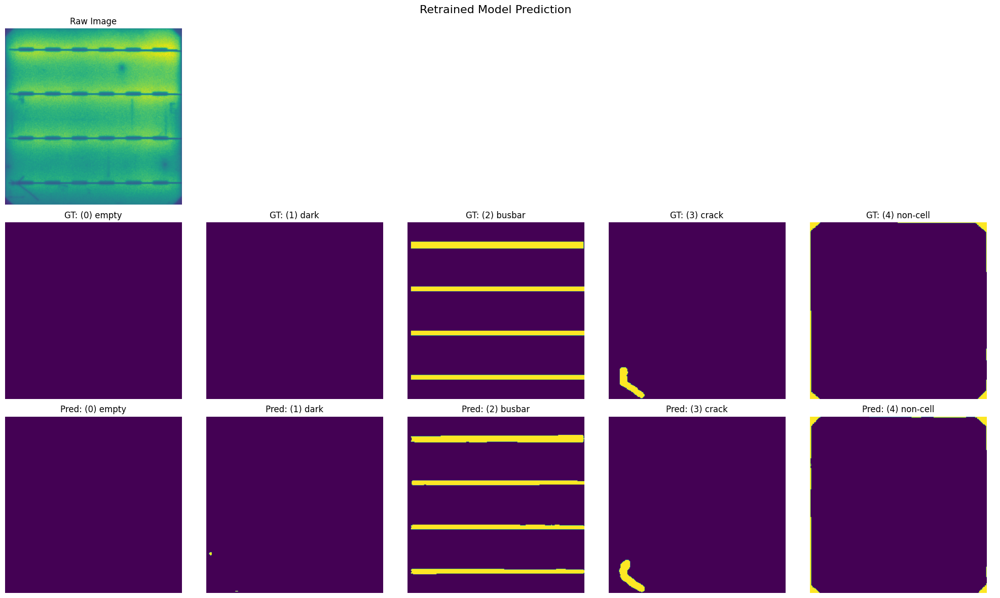

In [14]:
new_inference_and_show(-32)

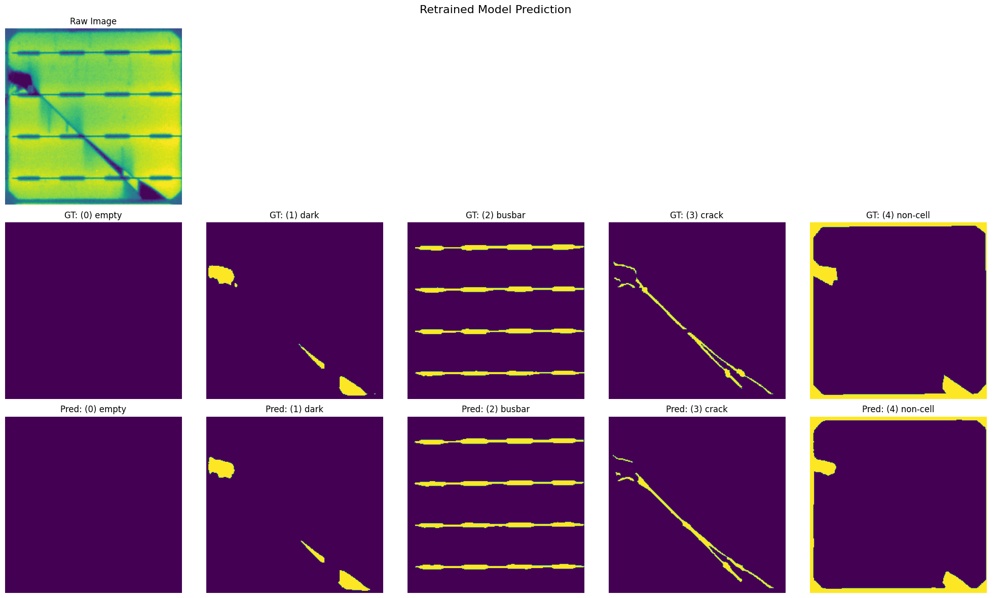

In [15]:
new_inference_and_show(13)

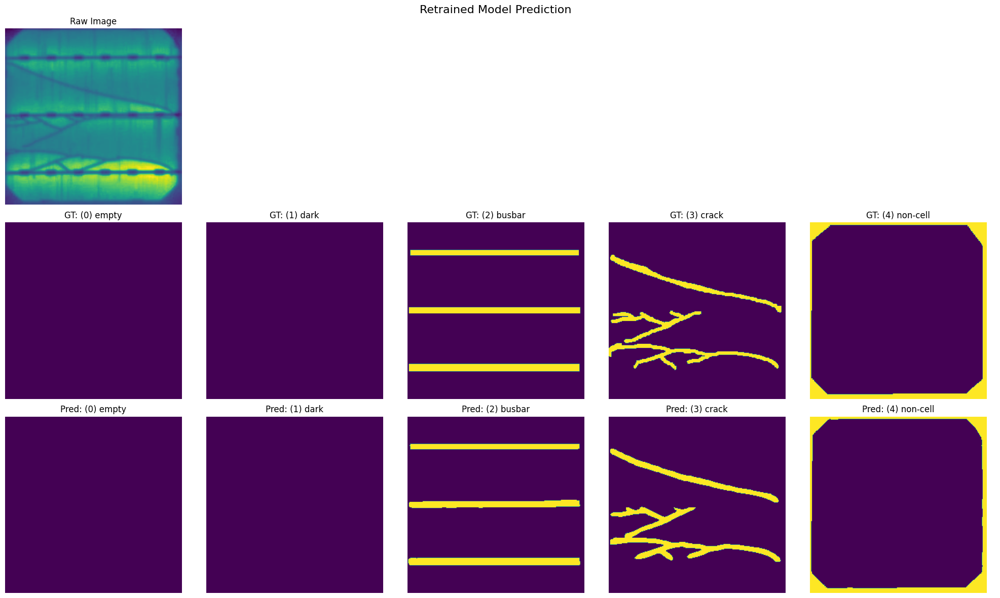

In [16]:
new_inference_and_show(44)

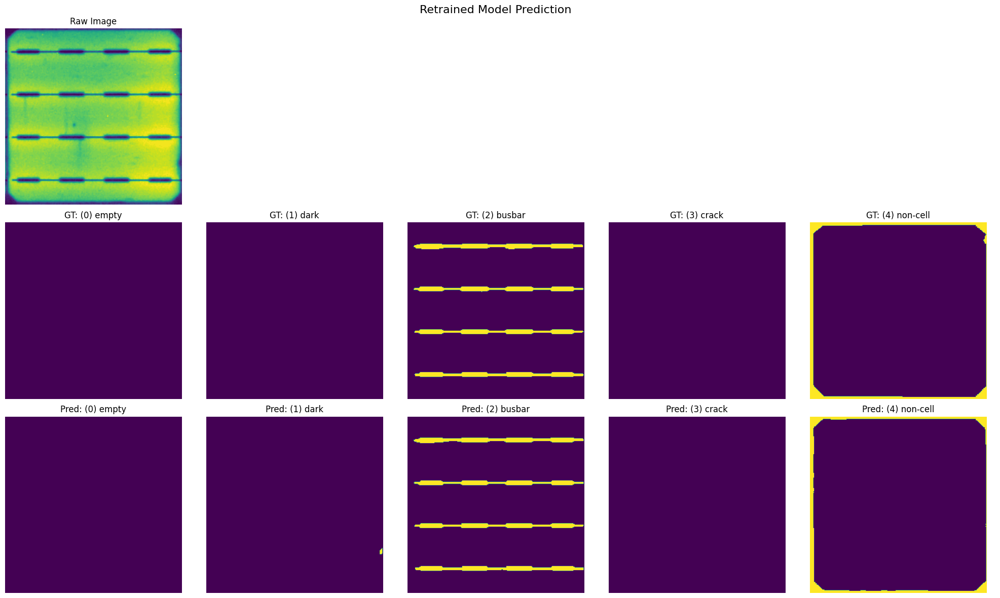

In [17]:
new_inference_and_show(1)

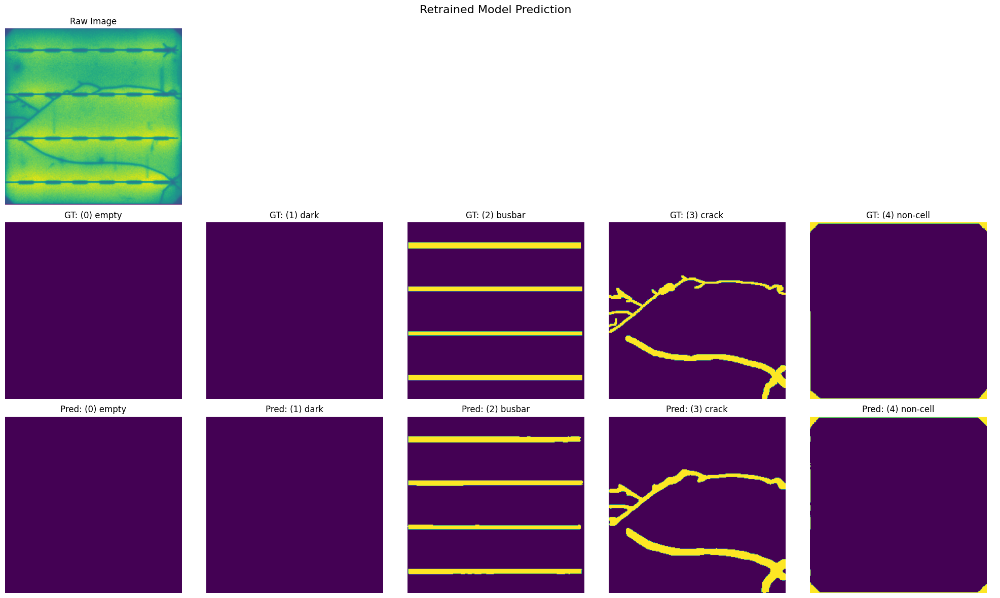

In [18]:
new_inference_and_show(6)

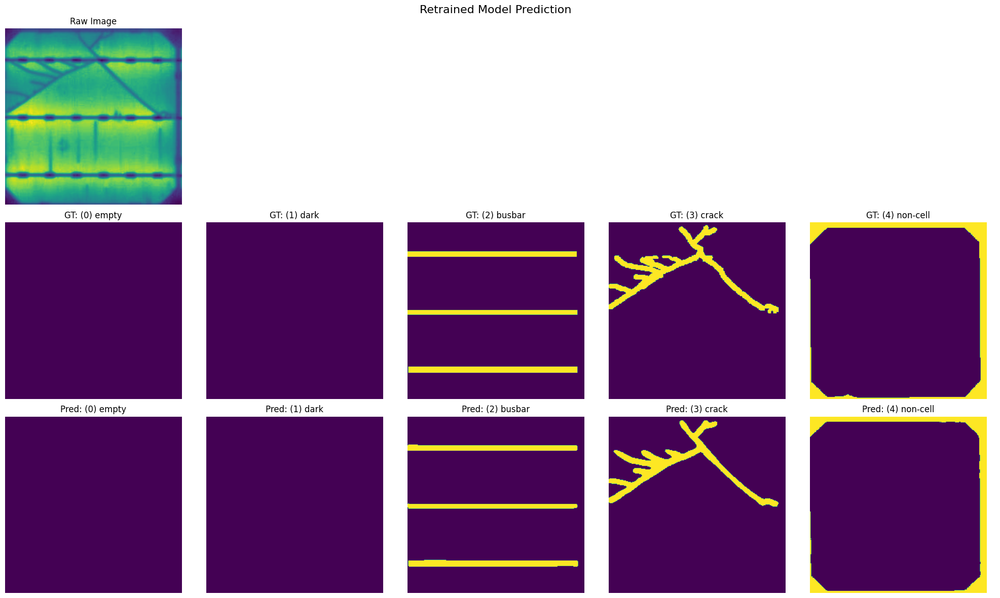

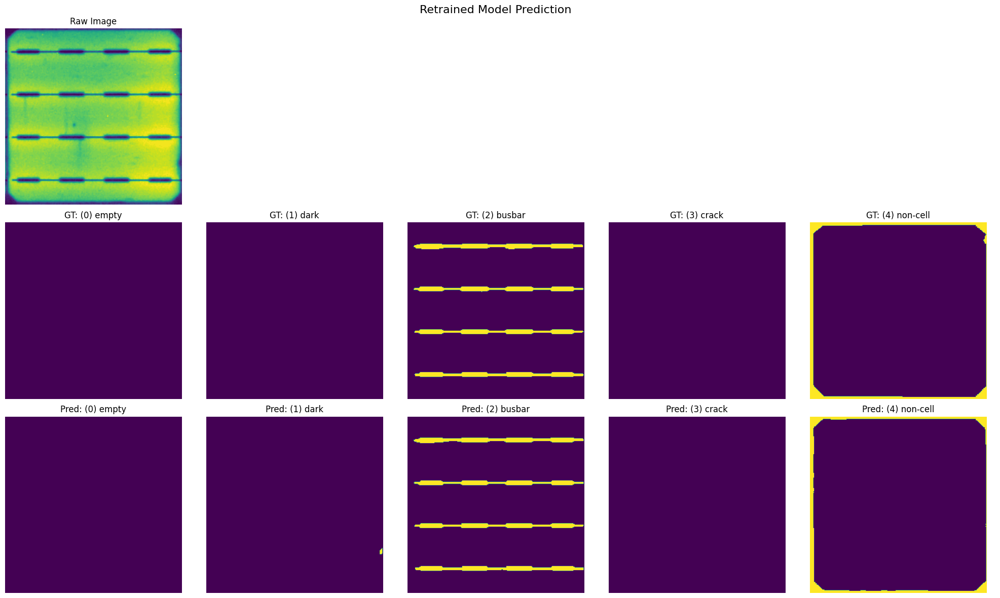

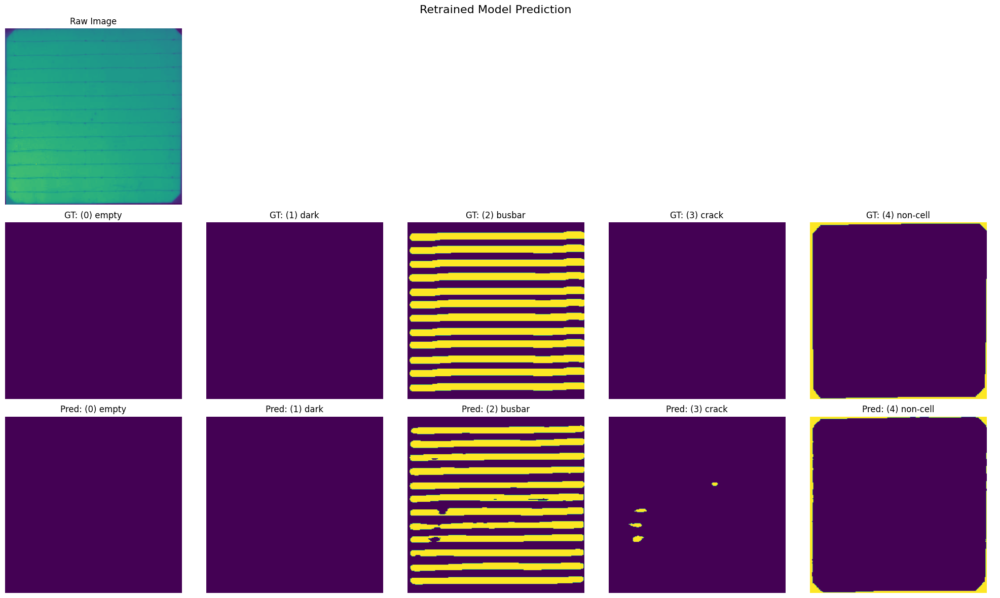

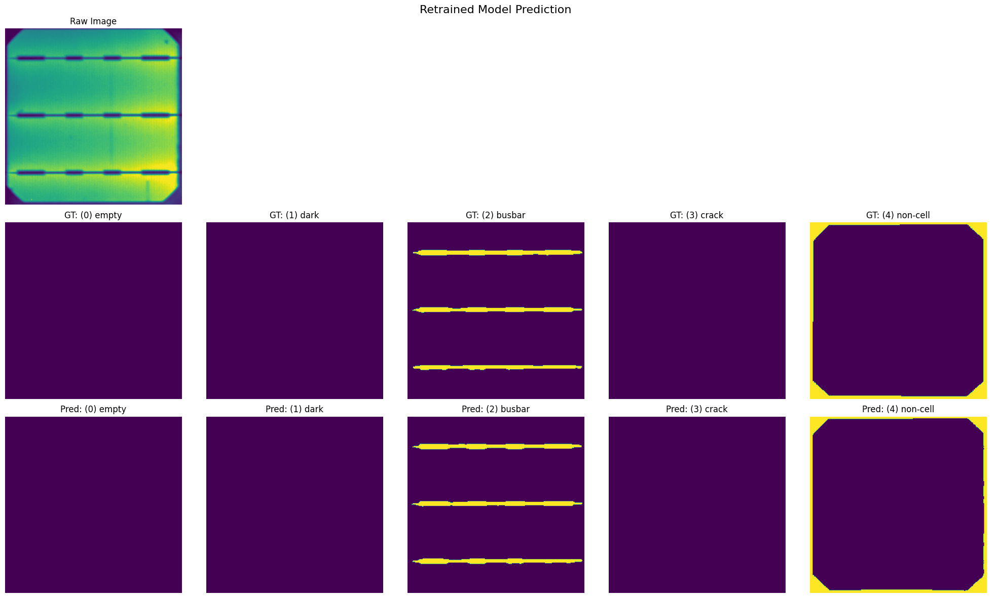

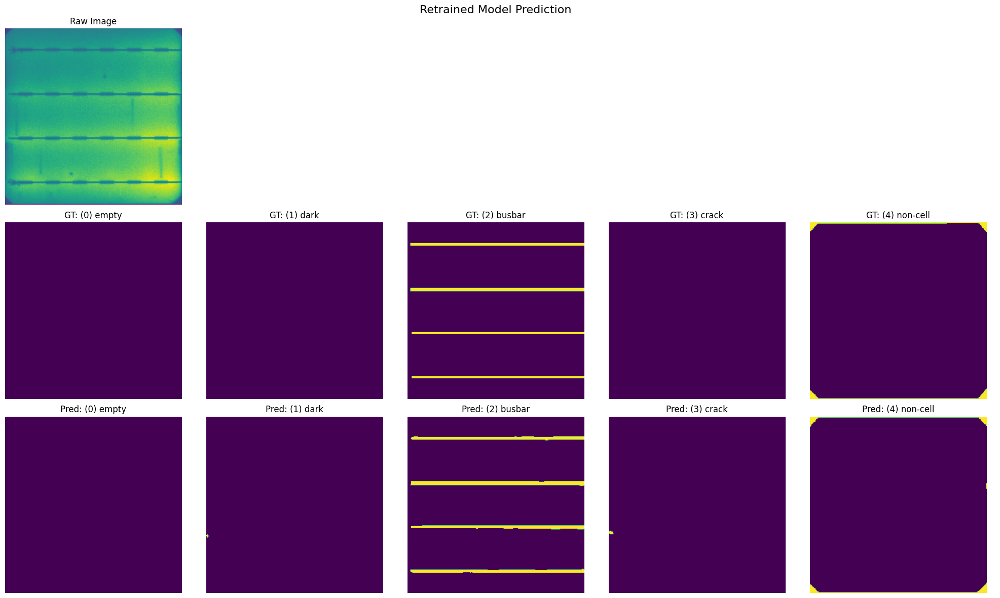

...

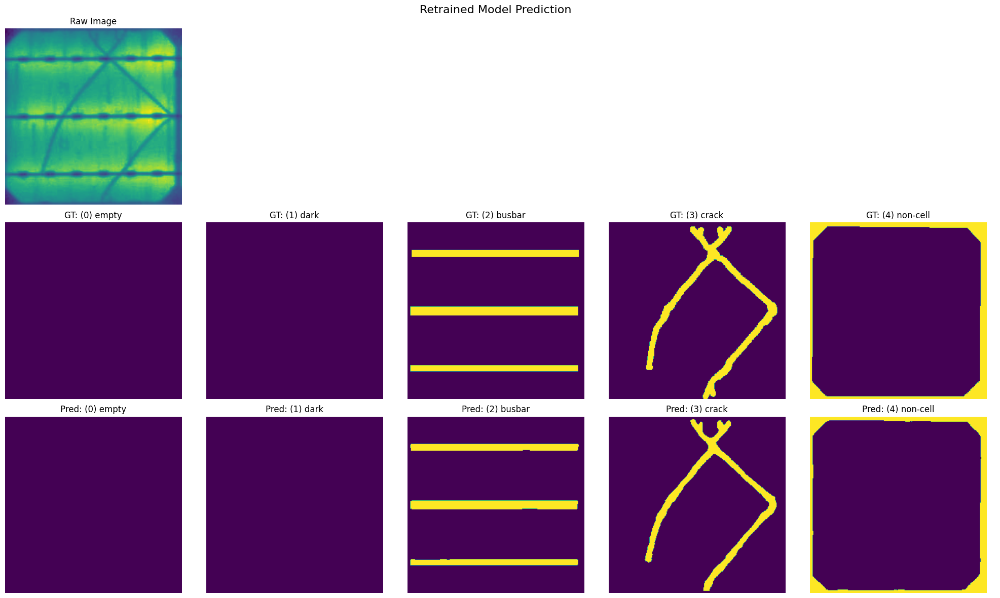

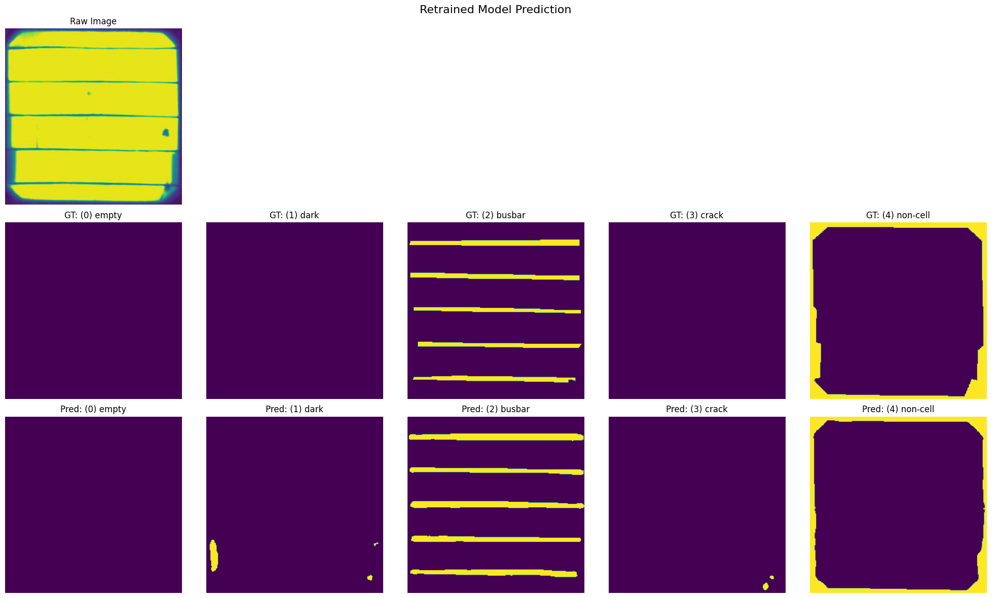

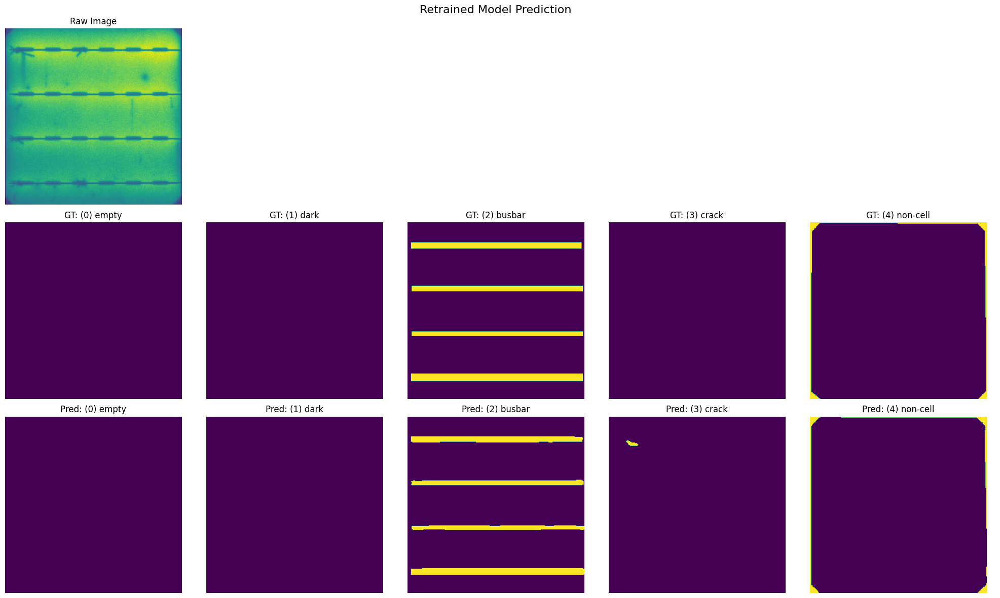

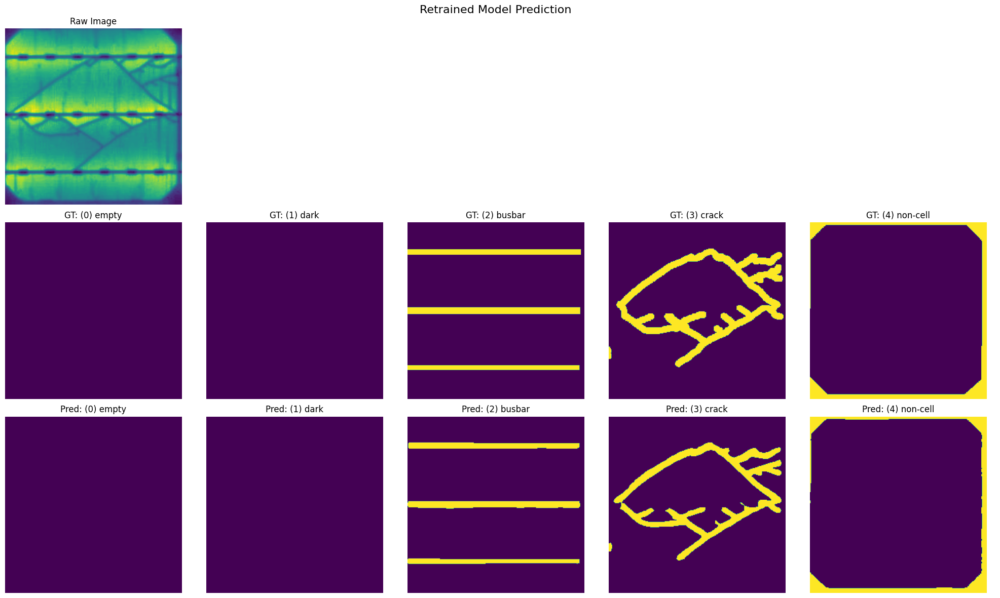

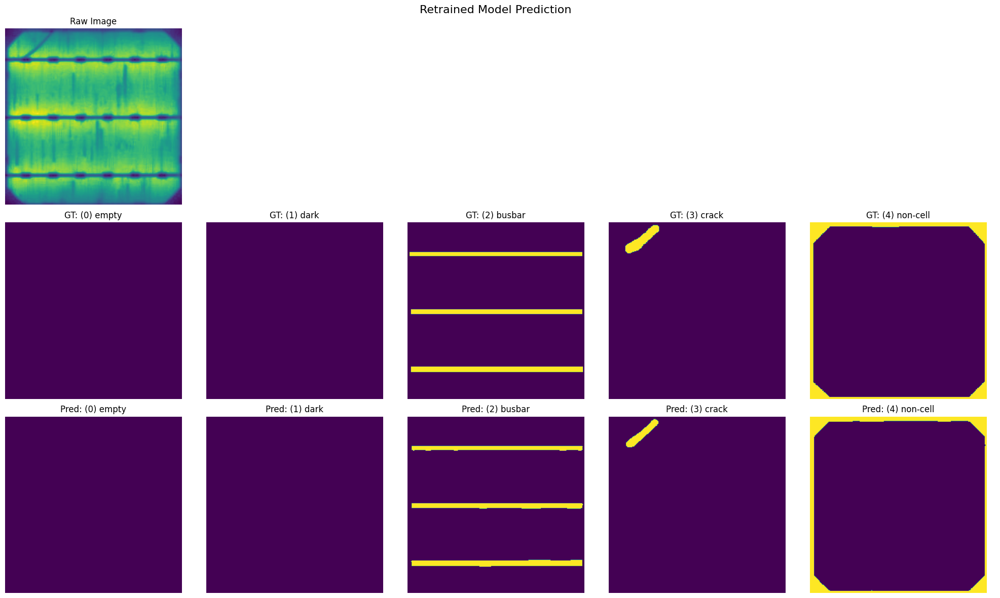

In [19]:
for i in range(100):
    new_inference_and_show(i)

[np.float64(0.3584204912525103), np.float64(0.16443245150233726), np.float64(0.0917439250899203), np.float64(0.060988001847864556), np.float64(0.04640322598652036), np.float64(0.03832920271572328), np.float64(0.03454253598114217), np.float64(0.031327112605434616), np.float64(0.028437859317232646), np.float64(0.026903934723746397), np.float64(0.02576923362724059), np.float64(0.025077928774109734), np.float64(0.025141418578446862), np.float64(0.02301092489552525), np.float64(0.02202494918731527), np.float64(0.021472316396535122), np.float64(0.02089213275675214), np.float64(0.020039247390273154), np.float64(0.01894047044658851), np.float64(0.018213068442694963), np.float64(0.017337644018725003), np.float64(0.016351044923703532), np.float64(0.015880717430263758), np.float64(0.014703498604858044), np.float64(0.014064456942938862), np.float64(0.01327878899409824), np.float64(0.012662397624377441), np.float64(0.012285469274900021), np.float64(0.011649276735579302), np.float64(0.01097484733506

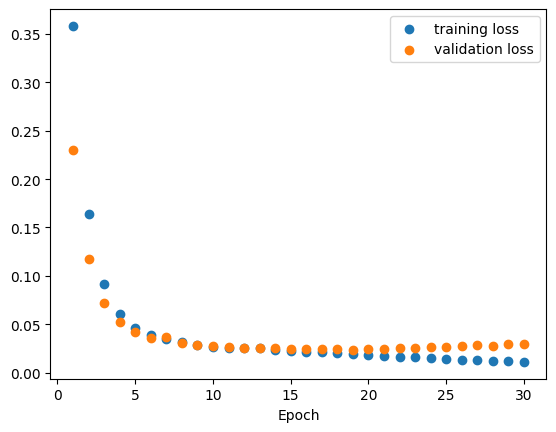

In [20]:
fig, ax = plt.subplots()

x = np.arange(1, len(training_epoch_loss) + 1, 1)

ax.scatter(x, training_epoch_loss, label="training loss")
ax.scatter(x, val_epoch_loss, label="validation loss")
ax.legend()
ax.set_xlabel("Epoch")

print(training_epoch_loss)

In [21]:
val_epoch_loss

[np.float64(0.22979054209731875),
 np.float64(0.11754311737762828),
 np.float64(0.07231542800052636),
 np.float64(0.052585852009301284),
 np.float64(0.04149006044834244),
 np.float64(0.03606741496545522),
 np.float64(0.036994198970750077),
 np.float64(0.03007196268814356),
 np.float64(0.02861990494539543),
 np.float64(0.0269976427626549),
 np.float64(0.026583118060109566),
 np.float64(0.02556496415743414),
 np.float64(0.02568373625755918),
 np.float64(0.025386529271395838),
 np.float64(0.02419520327884729),
 np.float64(0.024777833442045313),
 np.float64(0.024631495967659414),
 np.float64(0.02394149655818331),
 np.float64(0.023805915821521056),
 np.float64(0.024180472068184494),
 np.float64(0.02453734367122861),
 np.float64(0.024883842710278877),
 np.float64(0.025528942735320855),
 np.float64(0.026004209252847296),
 np.float64(0.026635974487226433),
 np.float64(0.02705118580258825),
 np.float64(0.028213085182213864),
 np.float64(0.027884653535018972),
 np.float64(0.029041111621321464),
